In [3]:
import geopandas as gpd
import pandas as pd

In [4]:
# Link: http://terrabrasilis.dpi.inpe.br/download/dataset/amz-prodes/vector/yearly_deforestation_biome.zip
# You have to put all the files in the same folder

shapefile = gpd.read_file(r'D:\Usuários\Fernando_Roriz\UC_Berkeley\Capstone\Data\Yearly_Deforestation_Biome\yearly_deforestation_biome.shp')

In [5]:
# Link: http://terrabrasilis.dpi.inpe.br/download/dataset/amz-aux/vector/states_amazon_biome.zip
# You have to put all the files in the same folder

shapefile_biome = gpd.read_file(r'D:\Usuários\Fernando_Roriz\UC_Berkeley\Capstone\Data\states_amazon_biome.shp')

In [6]:
shapefile_biome

,id,nome,sigla,geocodigo,geometry
0,2,Rondônia,RO,11,"MULTIPOLYGON (((-59.98861 -11.91000, -59.98811..."
1,3,Acre,AC,12,"POLYGON ((-66.62735 -9.89885, -66.62730 -9.899..."
2,4,Amazonas,AM,13,"POLYGON ((-73.79834 -7.11298, -73.79827 -7.112..."
3,5,Roraima,RR,14,"POLYGON ((-60.18882 5.23222, -60.15748 5.23044..."
4,6,Pará,PA,15,"MULTIPOLYGON (((-46.38414 -1.03655, -46.38429 ..."
5,7,Amapá,AP,16,"MULTIPOLYGON (((-49.98155 0.87511, -49.98229 0..."
6,8,Tocantins,TO,17,"POLYGON ((-47.89974 -5.25030, -47.89995 -5.250..."
7,14,Mato Grosso,MT,51,"MULTIPOLYGON (((-50.35017 -9.83338, -50.35059 ..."
8,26,Maranhão,MA,21,"MULTIPOLYGON (((-44.08515 -2.41669, -44.08560 ..."


In [7]:
shapefile_biome.geometry[4]

In [8]:
shapefile_biome.geometry[7]

In [9]:
# Add polygons

poly1 = shapefile_biome.geometry[4]
poly2 = shapefile_biome.geometry[7]
mergedpoly = poly1.union(poly2)
mergedpoly


In [43]:
## Add polygons using a loop

# Start with the first shape
mergedpoly = shapefile_biome.geometry[0]

for i in range(1,len(shapefile_biome)):
    mergedpoly = mergedpoly.union(shapefile_biome.geometry[i])

mergedpoly   

In [11]:
# To open BDQueimadas data, unzip files from google drive to specific local folder and adjust the path

path_2017 = r'D:\Usuários\Fernando_Roriz\UC_Berkeley\Capstone\Data\Focos_2017-01-01_2017-12-31.csv'
path_2018 = r'D:\Usuários\Fernando_Roriz\UC_Berkeley\Capstone\Data\Focos_2018-01-01_2018-12-31.csv'
path_2019 = r'D:\Usuários\Fernando_Roriz\UC_Berkeley\Capstone\Data\Focos_2019-01-01_2019-12-31.csv'
path_2020_1Q = r'D:\Usuários\Fernando_Roriz\UC_Berkeley\Capstone\Data\Focos_2020-01-01_2020-03-31.csv'
path_2020_2Q = r'D:\Usuários\Fernando_Roriz\UC_Berkeley\Capstone\Data\Focos_2020-04-01_2020-06-30.csv'
path_2020_3Q = r'D:\Usuários\Fernando_Roriz\UC_Berkeley\Capstone\Data\Focos_2020-07-01_2020-09-30.csv'
path_2020_4Q = r'D:\Usuários\Fernando_Roriz\UC_Berkeley\Capstone\Data\Focos_2020-10-01_2020-12-31.csv'
path_2021 = r'D:\Usuários\Fernando_Roriz\UC_Berkeley\Capstone\Data\Focos_2021-01-01_2021-12-31.csv'
path_2022 = r'D:\Usuários\Fernando_Roriz\UC_Berkeley\Capstone\Data\Focos_2022-01-01_2022-09-09.csv'

In [12]:
df17 = pd.read_csv(path_2017)
df18 = pd.read_csv(path_2018)
df19 = pd.read_csv(path_2019)
df20_1Q = pd.read_csv(path_2020_1Q)
df20_2Q = pd.read_csv(path_2020_2Q)
df20_3Q = pd.read_csv(path_2020_3Q)
df20_4Q = pd.read_csv(path_2020_4Q)
df21 = pd.read_csv(path_2021)
df22 = pd.read_csv(path_2022)

In [13]:
df = pd.concat([df17, df18, df19, df20_1Q, df20_2Q, df20_3Q, df20_4Q, df21, df22], axis=0)

In [14]:
df.head()

,datahora,satelite,pais,estado,municipio,bioma,diasemchuva,precipitacao,riscofogo,latitude,longitude,frp
0,2017/09/01 03:57:00,NPP-375D,Brasil,GOIAS,ARAGUAPAZ,Cerrado,0.0,0.0,1.0,-15.19956,-50.52937,NaN
1,2017/09/01 03:57:00,NPP-375D,Brasil,MATO GROSSO,ARAGUAIANA,Cerrado,0.0,0.0,1.0,-14.96275,-51.70120,NaN
2,2017/09/01 03:57:00,NPP-375D,Brasil,GOIAS,MIMOSO DE GOIAS,Cerrado,0.0,0.0,1.0,-15.02494,-48.58707,NaN
3,2017/09/01 05:38:00,NPP-375D,Brasil,MATO GROSSO,ARAGUAIANA,Cerrado,0.0,0.0,1.0,-14.96229,-51.63469,NaN
4,2017/09/01 03:59:00,NPP-375D,Brasil,SAO PAULO,MOCOCA,Cerrado,0.0,0.0,1.0,-21.36933,-47.03375,NaN


In [15]:
# Restrict dataset to specific satellite, state and biome

df_pa = df[(df['satelite']=='NPP-375') & (df['estado']=='PARA') & (df['bioma']=='Amazonia')].reset_index()

In [17]:
%matplotlib inline
from shapely.geometry import Point, Polygon
from geopandas import datasets, GeoDataFrame, read_file
from geopandas.tools import overlay

In [18]:
## Create lat-long points in geopandas

crs = {'init':'EPSG:4326'}
geometry = [Point(xy) for xy in zip(df_pa['longitude'], df_pa['latitude'])]
geo_df = gpd.GeoDataFrame(df_pa, 
                          crs = crs, 
                          geometry = geometry)

D:\Anaconda\lib\site-packages\pyproj\crs\crs.py:131: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [19]:
# Create shapefile for Para
shp_state_pa = shapefile_biome[shapefile_biome['sigla']=='PA']
shp_state_pa.head()

,id,nome,sigla,geocodigo,geometry
4,6,Pará,PA,15,"MULTIPOLYGON (((-46.38414 -1.03655, -46.38429 ..."


In [20]:
# Create shapefile for Amazonas
shp_state_am = shapefile_biome[shapefile_biome['sigla']=='AM']
shp_state_am.head()

,id,nome,sigla,geocodigo,geometry
2,4,Amazonas,AM,13,"POLYGON ((-73.79834 -7.11298, -73.79827 -7.112..."


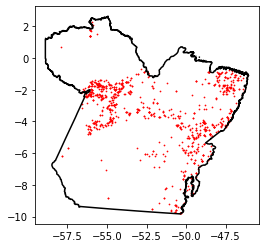

In [21]:
## Plot test. Plot the first 1000 registered fires inside Para

import matplotlib.pyplot as plt

fig, ax = plt.subplots()

ax.set_aspect('equal')

shp_state_pa.boundary.plot(ax=ax, edgecolor='black')

geo_df[0:1000].plot(ax=ax, color='red', markersize=0.5)

plt.show()

In [22]:
# Test if a point is inside a polygon

pol = shapefile_biome.geometry[4]
pnt = geo_df.geometry[0]
pnt.within(pol)

True

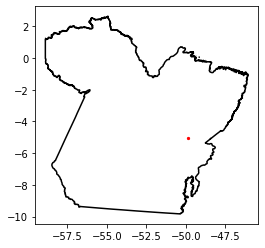

In [25]:
fig, ax = plt.subplots()

ax.set_aspect('equal')

shp_state_pa.boundary.plot(ax=ax, edgecolor='black')

geo_df[0:1].plot(ax=ax, color='red', markersize=5)

plt.show()

In [26]:
# Test using a loop. 
# In this example, everything will be true because we restricted everything to Para

for i in range(len(geo_df[0:10])):
    print(geo_df.geometry[i].within(shapefile_biome.geometry[4]))

True
True
True
True
True
True
True
True
True
True


In [27]:
# For the same example above, but testing for Mato Grosso, everything is out

for i in range(len(geo_df[0:10])):
    print(geo_df.geometry[i].within(shapefile_biome.geometry[7]))

False
False
False
False
False
False
False
False
False
False


In [28]:
deforested_pa = shapefile[shapefile['state']=='PA']

In [29]:
deforested_pa.head()

,uid,state,path_row,main_class,class_name,def_cloud,julian_day,image_date,year,area_km,scene_id,source,satellite,sensor,uuid,geometry
55,1558226,PA,22464,DESMATAMENTO,d2016,0.0,208.0,2016-07-26,2016.0,0.014728,100263.0,None,None,None,78dd93b6-8234-4080-a9a1-d71b6bd4bfc5,"POLYGON ((-49.82841 -5.65815, -49.82841 -5.657..."
60,581121,PA,22862,DESMATAMENTO,d2010,0.0,283.0,2010-10-10,2010.0,0.000013,1138.0,None,None,None,dd491f8e-df74-4749-b8dc-7d31f17e9f7d,"POLYGON ((-55.80007 -2.98372, -55.80007 -2.983..."
66,1545067,PA,22464,DESMATAMENTO,d2009,0.0,220.0,2009-08-08,2009.0,0.059863,816.0,None,None,None,d2217b3e-7124-45ee-8cc9-c24d54a959b9,"POLYGON ((-49.75312 -5.65300, -49.75312 -5.652..."
118,1546404,PA,22464,DESMATAMENTO,d2010,0.0,207.0,2010-07-26,2010.0,0.053833,1049.0,None,None,None,0b57e8a2-a9db-4690-a626-a2dcd026522f,"POLYGON ((-49.75000 -5.72025, -49.75000 -5.718..."
126,590379,PA,22762,DESMATAMENTO,d2015,0.0,226.0,2015-08-14,2015.0,0.000291,2571.0,None,None,None,f2354127-1543-453f-8675-a33fe79b708f,"POLYGON ((-54.64673 -2.97552, -54.64671 -2.975..."


In [30]:
deforested_pa.geometry[0:1]

55    POLYGON ((-49.82841 -5.65815, -49.82841 -5.657...
Name: geometry, dtype: geometry

In [31]:
# Test if a polygon is inside another polygon

# Using Para, the answer will be True

poly_pa = shapefile_biome.geometry[4]
poly_def = deforested_pa.geometry[0:1]
poly_def.within(poly_pa)

55    True
dtype: bool

In [32]:
# Using Amazonas, the answer will be False

poly_pa = shapefile_biome.geometry[2]
poly_def = deforested_pa.geometry[0:1]
poly_def.within(poly_pa)

55    False
dtype: bool

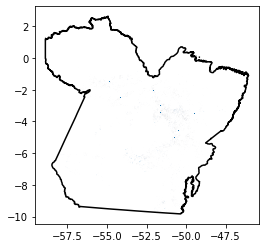

In [33]:
fig, ax = plt.subplots()

ax.set_aspect('equal')

shp_state_pa.boundary.plot(ax=ax, edgecolor='black')

deforested_pa.geometry[0:10000].plot(ax=ax)

plt.show()

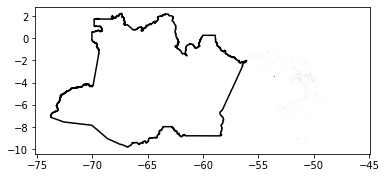

In [34]:
fig, ax = plt.subplots()

ax.set_aspect('equal')

shp_state_am.boundary.plot(ax=ax, edgecolor='black')

deforested_pa.geometry[0:10000].plot(ax=ax)

plt.show()

In [35]:
deforested_pa[deforested_pa['class_name']=='d2008']['area_km'].sum()

5622.549062588711

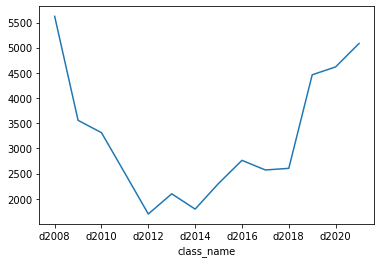

In [36]:
# Deforestation increments - Amazon Biome - State of Para

deforested_pa.groupby(['class_name'])['area_km'].sum().plot()

In [38]:
## Using deforested_pa
def_test = deforested_pa[deforested_pa['class_name']=='d2010'][0:2000].reset_index()

## Add polygon from any specific date

# Start with the first shape
mergedpoly = def_test.geometry[0]

for i in range(1,len(def_test)):
    mergedpoly = mergedpoly.union(def_test.geometry[i])

mergedpoly 

In [40]:
## Using deforested_pa
def_test = deforested_pa[deforested_pa['class_name']=='d2020'][0:2000].reset_index()

## Add polygon from any specific date

# Start with the first shape
mergedpoly = def_test.geometry[0]

for i in range(1,len(def_test)):
    mergedpoly = mergedpoly.union(def_test.geometry[i])

mergedpoly 

Found - i: 8 , count: 11104


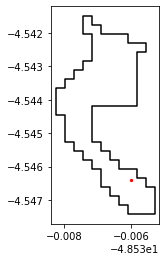

Found - i: 40 , count: 175062


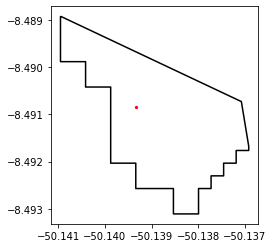

Found - i: 45 , count: 65003


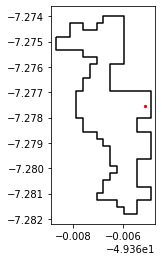

Found - i: 48 , count: 219203


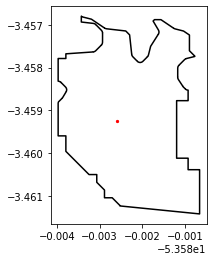

Wall time: 6min 14s


In [42]:
%%time
def_pa_aux = deforested_pa.reset_index()

for i in range(len(geo_df[0:50])):
    pnt_aux = geo_df.geometry[i]
    #print(pnt_aux)
    count = 0
    while True:
        poly_aux = def_pa_aux.geometry[count]
        if count >= len(def_pa_aux)-1:
            #print("Break count")
            break
        if pnt_aux.within(poly_aux) == False:
            count += 1
            continue
        if pnt_aux.within(poly_aux) == True:
            print("Found - i:", i, ", count:", count)
            fig, ax = plt.subplots()

            ax.set_aspect('equal')

            def_pa_aux[count:count+1].boundary.plot(ax=ax, edgecolor='black')

            geo_df[i:i+1].plot(ax=ax, color='red', markersize=5)

            plt.show()
            
            break
        
            